## Computer Vision Project 2 - Game of Blackjack
- Kacper Trębacz

- Jan Gruszczyński

# Notebook role:

Detecting singiel card, cutting the background. Creation of cutted and straightened card images used for model training. Detection of card symbols and creation of bounding boxes.


In this notebook, we detect cards on a bleek background, then cut them from the background. Then cards need to be straightened, and aligned properly to both axes. After this we detect symbols of cards, and find the coordinate of bounding boxes that contain them. All of this is performed on photos of cards made from our deck of cards. In the result we obtain 52 cutted cards from the background and bounding boxes of their symbols, and this data we use to create an artificial synthetic dataset of cards. Coordinates of bounding boxes are saved to a json file.


In [7]:
from IPython.display import display, HTML
try:
    import Image
except ImportError:
    from PIL import Image
def display_image(img):
    if not isinstance(img, str):
         display(Image.fromarray(img))
    else:
        display(Image.fromarray(cv2.imread(img, cv2.IMREAD_COLOR))) 

Example of a card going in:

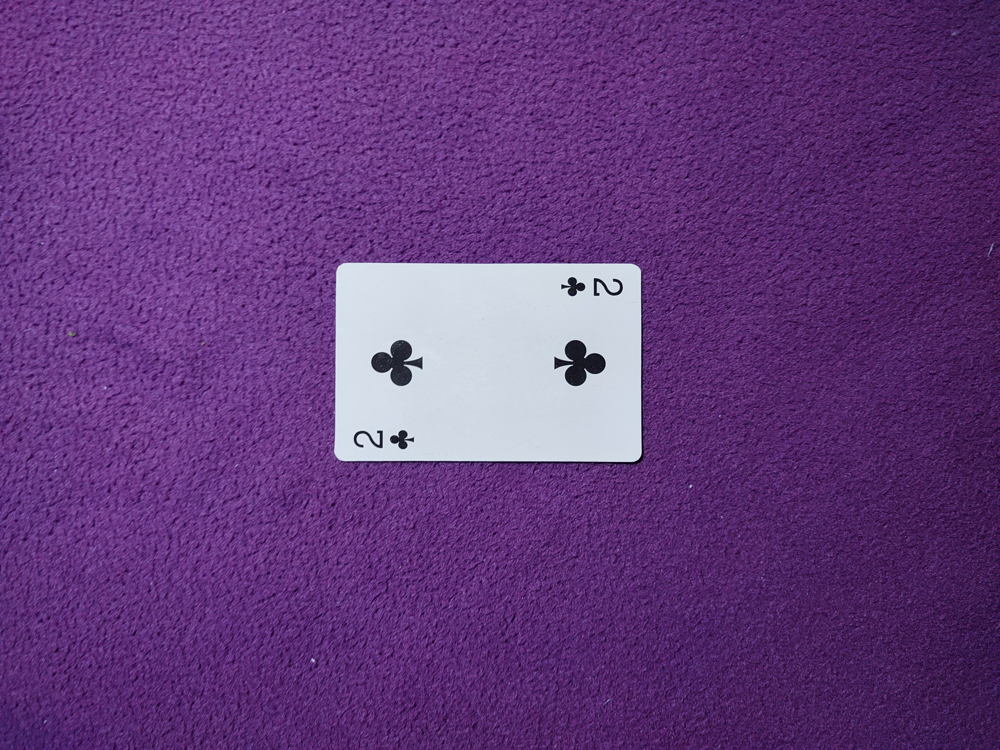

In [6]:
display_image("photos/52-deck/1640874547058.jpg")

Example of a result:

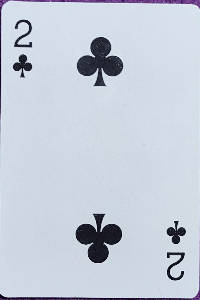

In [5]:
display_image("photos/52-deck-cutted/C2.png")
# Please note in the actuall image background has alpha = 0, so its perfectly cutted out. But cv2 converts from RGBA
# to RGB without taking alpha into account
# Bounding boxes showed in the next notebook.

In [4]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import imutils
import json

In [8]:
def draw_rect(img, rect):
    return cv2.rectangle(img, (int(rect[0]), int(rect[1])), \
              (int(rect[0]+rect[2]), int(rect[1]+rect[3])), (90,255,0), 2)

In [9]:
path_to_images = Path("photos/52-deck")
img_paths = [path for path in path_to_images.iterdir()]

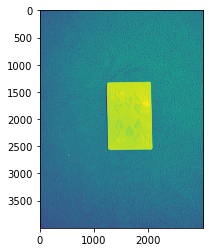

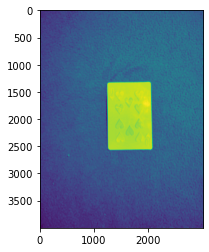

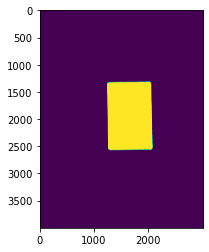

got conture


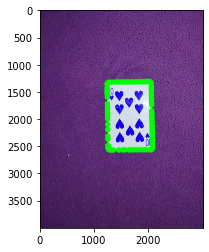

In [13]:
img = cv2.imread(str(img_paths[8]))
gray = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)[:,:,2]
plt.imshow(gray)
plt.show()
blur = cv2.GaussianBlur(gray,(33,33),10,10)
plt.imshow(blur)
plt.show()

thresh_level = 100

_, thresh = cv2.threshold(blur,thresh_level,255,cv2.THRESH_BINARY + cv2.THRESH_OTSU)
plt.imshow(thresh)
plt.show()

contours,hierarchy = cv2.findContours(thresh,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)
index_sort = sorted([i for i in range(len(contours))], key=lambda i : cv2.contourArea(contours[i]),reverse=True)

contours_s = [contours[i] for i in index_sort]
hierarchy_s = [hierarchy[0][i] for i in index_sort]

for i in range(len(contours_s)):
    size = cv2.contourArea(contours_s[i])
    peri = cv2.arcLength(contours_s[i],True)
    approx = cv2.approxPolyDP(contours_s[i],0.01*peri,True)

    if ((size > 30)
        and (hierarchy_s[i][3] == -1) and (len(approx) in [4,5,6,7,8])):
        print("got conture")
        cv2.drawContours(img, contours_s[i], -1, (0, 255, 0), 100)
        
plt.imshow(img)

In [14]:
cardW=200
cardH=300
cornerXmin=3
cornerXmax=33
cornerYmin=7
cornerYmax=82

In [15]:
def scale_contour(cnt, scale):
    M = cv2.moments(cnt)
    cx = int(M['m10']/M['m00'])
    cy = int(M['m01']/M['m00'])

    cnt_norm = cnt - [cx, cy]
    cnt_scaled = cnt_norm * scale
    cnt_scaled = cnt_scaled + [cx, cy]
    cnt_scaled = cnt_scaled.astype(np.int32)

    return cnt_scaled

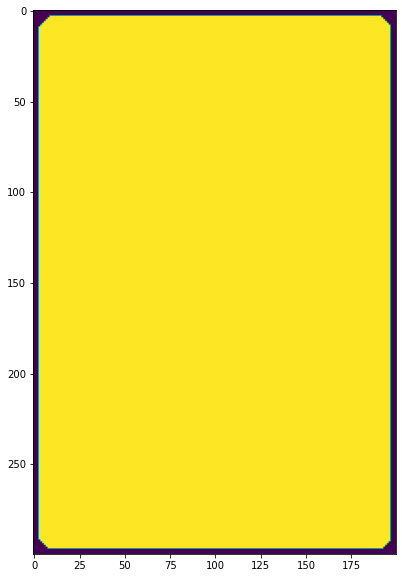

In [16]:
bord_size=3
alphamask=np.ones((cardH,cardW),dtype=np.uint8)*255
cv2.rectangle(alphamask,(0,0),(cardW-1,cardH-1),0,bord_size)
cv2.line(alphamask,(bord_size*3,0),(0,bord_size*3),0,bord_size)
cv2.line(alphamask,(cardW-bord_size*3,0),(cardW,bord_size*3),0,bord_size)
cv2.line(alphamask,(0,cardH-bord_size*3),(bord_size*3,cardH),0,bord_size)
cv2.line(alphamask,(cardW-bord_size*3,cardH),(cardW,cardH-bord_size*3),0,bord_size)
plt.figure(figsize=(10,10))
plt.imshow(alphamask)

In [17]:
def straighten_card(image, pts, w, h):
    from_ = np.zeros((4,2), dtype = "float32")
    
    s = np.sum(pts, axis = 2)

    tl = pts[np.argmax(s)]
    br = pts[np.argmin(s)]

    diff = np.diff(pts, axis = -1)
    tr = pts[np.argmax(diff)]
    bl = pts[np.argmin(diff)]

    if w < h:
        from_[0], from_[1], from_[2], from_[3] = tl,tr,br,bl
    else:
        from_[0], from_[1], from_[2], from_[3] = bl,tl,tr,br
            
    
    
    to_ = np.array([[0,0],[cardW-1,0],[cardW-1,cardH-1],[0, cardH-1]], np.float32)
    M = cv2.getPerspectiveTransform(from_,to_)
    return cv2.warpPerspective(image, M, (cardW, cardH))

def detect_cards(img, debug = False):
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray,(33,33),10,10)
    thresh_level = 103

    retval, thresh = cv2.threshold(blur,thresh_level,255,cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    contours,hierarchy = cv2.findContours(thresh,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)
    index_sort = sorted([i for i in range(len(contours))], key=lambda i : cv2.contourArea(contours[i]),reverse=True)

    contours_s = [contours[i] for i in index_sort]
    hierarchy_s = [hierarchy[0][i] for i in index_sort]

    cards,corners = [],[]
    for i in range(len(contours_s)):
        size = cv2.contourArea(contours_s[i])
        peri = cv2.arcLength(contours_s[i],True)
        approx = cv2.approxPolyDP(contours_s[i],0.01*peri,True)

        if ((size > 30)
            and (hierarchy_s[i][3] == -1) and (len(approx) in [4,5,6,7,8])):
            cont = scale_contour(contours_s[i], 1.03)#scaling to include contours
            cards.append(cont)
            corners.append(cv2.approxPolyDP(cont,0.01*peri,True))
    ready_cards = []
    for card, corn in zip(cards,corners):
        x,y,w,h = cv2.boundingRect(corn)
        straightened_card = straighten_card(img,corn,w,h)
        straightened_card = cv2.cvtColor(straightened_card,cv2.COLOR_BGR2BGRA)
        straightened_card[:,:,3]=alphamask
        first_box = findBox(straightened_card, topCorner, name="Top",debug=debug)
        second_box = findBox(straightened_card, lowCorner, name="Bottom",debug=debug)
        if debug:
            cv2.imshow("carde", straightened_card)
            mid_point = np.sum(corn, axis = 0)/corn.shape[0]
            mid_point = mid_point[0].astype(np.int32)
            cv2.drawContours(img, card, -1, (0, 255, 0), 10)
            img = cv2.circle(img, (mid_point[0],mid_point[1]), radius=10, color=(0, 0, 255), thickness=-1)
            cv2.imshow('video', cv2.resize(img,(450,800)))
        ready_cards.append((straightened_card,first_box,second_box))
    return ready_cards

## VIDEO

In [18]:
# video = cv2.VideoCapture(str(Path('PATH-TO-VIDEOS')))
# # video = cv2.VideoCapture(str(Path('/photos/j1/VID_20211229_170039.mp4')))
# wrong_image = None
# while True:
#     if video.grab():
#         flag, frame = video.retrieve()
#         if not flag:
#             continue
#         else:
#             cv2.imshow('video', cv2.resize(detect_cards(frame.copy()),(450,800)))
#     if cv2.waitKey(10) == 27:
#         break
#     if cv2.waitKey(10) == 32:
#         wrong_image = frame

In [19]:
topCorner=np.array([[cornerXmin,cornerYmin],[cornerXmax,cornerYmin],[cornerXmax,cornerYmax],[cornerXmin,cornerYmax]],dtype=np.float32)
lowCorner=np.array([[cardW-cornerXmax,cardH-cornerYmax],[cardW-cornerXmin,cardH-cornerYmax],[cardW-cornerXmin,cardH-cornerYmin],[cardW-cornerXmax,cardH-cornerYmin]],dtype=np.float32)

In [20]:

def findBox(img,corner, name = "Top", debug=False):
    
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
#     kernel = np.ones((5,5),np.uint8)
    corner=corner.astype(np.int)
    x1,y1,x2,y2=int(corner[0][0]), int(corner[0][1]), int(corner[2][0]), int(corner[2][1])
    w=x2-x1
    h=y2-y1
    zone=img[y1:y2,x1:x2].copy()

    gray=cv2.cvtColor(zone,cv2.COLOR_BGR2GRAY)
    thld=cv2.Canny(gray,30,200)
    cv2.imshow("canny", thld)
    thld = cv2.dilate(thld,kernel,iterations=1)
    if debug: cv2.imshow("thld",thld)
    
    contours, _= cv2.findContours(thld, cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)

    min_area=5
    concat_contour=None
    
    for c in contours:
        area=cv2.contourArea(c)
        hull = cv2.convexHull(c)
        hull_area = cv2.contourArea(hull)
        if area >= min_area:
            if debug :
                cv2.drawContours(zone,[c],0,(255,0,0),-1)
            if concat_contour is not None:
                concat_contour=np.concatenate((concat_contour,c))
            else:
                concat_contour=c
    
    if concat_contour is not None:
        concat_contour_in_image = concat_contour + corner[0]
        rect = cv2.boundingRect(concat_contour)
        
        pad = 5
        rect_in_image = list(cv2.boundingRect(concat_contour_in_image)) 
        rect_in_image[0] = max(rect_in_image[0] - pad,0)
        rect_in_image[1] = max(rect_in_image[1] - pad,0)
        rect_in_image[2] = min(rect_in_image[0] + rect_in_image[2] + 2*pad, img.shape[1])
        rect_in_image[3] = min(rect_in_image[1] + rect_in_image[3] + 2*pad,img.shape[0])
                             
        if debug:
            cv2.rectangle(zone, (int(rect[0]), int(rect[1])), (int(rect[2]), int(rect[3])), (90,255,0), 2)
            cv2.rectangle(img, (int(rect_in_image[0]), int(rect_in_image[1])), \
              (int(rect_in_image[2]), int(rect_in_image[3])), (90,255,0), 2)
            cv2.imshow("Zone"+name,zone)
            cv2.imshow("Image",img)
                             
        return rect_in_image
    return None

In [21]:
boxes = {}
for i,path in enumerate([p for p in Path("photos/52-deck").iterdir()]):
    card,first_box, second_box = detect_cards(cv2.imread(str(path)), debug=True)[0]
    add = [
        [(box[0],box[1]),(box[2],box[1]),(box[0],box[3]),(box[2],box[3])] 
        for box in [first_box,second_box]
    ]
    boxes[path.stem] = add
#     for card,first_box, second_box in detection:
    cv2.imshow("Image", card)
    cv2.waitKey(0)
    
#     cv2.imwrite(f"{path.stem}.png", card)

boxes

{'1640874547158': [[(4, 14), (37, 14), (4, 85), (37, 85)],
  [(163, 213), (196, 213), (163, 282), (196, 282)]],
 '1640874547444': [[(5, 15), (36, 15), (5, 87), (36, 87)],
  [(162, 213), (197, 213), (162, 282), (197, 282)]],
 '1640874547808': [[(5, 14), (36, 14), (5, 85), (36, 85)],
  [(162, 214), (193, 214), (162, 285), (193, 285)]],
 '1640874548143': [[(8, 11), (38, 11), (8, 78), (38, 78)],
  [(164, 223), (195, 223), (164, 292), (195, 292)]],
 '1640874548207': [[(8, 11), (38, 11), (8, 81), (38, 81)],
  [(162, 221), (192, 221), (162, 290), (192, 290)]],
 '1640874547704': [[(5, 17), (37, 17), (5, 85), (37, 85)],
  [(165, 214), (197, 214), (165, 283), (197, 283)]],
 '1640874548086': [[(6, 13), (38, 13), (6, 84), (38, 84)],
  [(162, 217), (192, 217), (162, 289), (192, 289)]],
 '1640874547302': [[(6, 13), (38, 13), (6, 81), (38, 81)],
  [(162, 215), (194, 215), (162, 284), (194, 284)]],
 '1640874548019': [[(6, 11), (38, 11), (6, 80), (38, 80)],
  [(164, 213), (197, 213), (164, 280), (197, 

In [22]:
content = json.dumps(boxes)
Path("boxes.json").write_text(content)

5666

In [ ]:
cv2.imwrite("card.jpg", detection[0][0])

In [ ]:
detection[0][1:]

## Used resources
- https://github.com/martinabeleda/Blackjack-Tracker
- https://github.com/geaxgx/playing-card-detection
- https://github.com/EdjeElectronics/OpenCV-Playing-Card-Detector